### Characterizing bursting dynamics of links (plotting results)

In [1]:
# Path to the toolbox
import sys; sys.path.insert(1, '/home/vinicius/storage1/projects/GrayData-Analysis')
import os 

# GDa functions
import GDa.stats.bursting                as     bst
from   GDa.session                       import session
from   GDa.temporal_network              import temporal_network
from   GDa.util                          import smooth

import matplotlib.pyplot                 as     plt
import matplotlib
import GDa.graphics.plot                 as     plot

import numpy                             as     np
import xarray                            as     xr


from   tqdm                              import tqdm
from   sklearn.manifold                  import TSNE
from   scipy                             import stats

#### Plotting and file saving configurations

In [2]:
SMALL_SIZE, MEDIUM_SIZE, BIGGER_SIZE = plot.set_plot_config()

In [3]:
# Create directory to save figures
if not os.path.exists("img/n5.0.0"):
    os.makedirs("img/n5.0.0")

In [4]:
# Bands names
band_names  = [r'band 1', r'band 2', r'band 3', r'band 4', r'band 5']
stages      = ['baseline', 'cue', 'delay', 'match']
_stats      = [r"$\mu$","std$_{\mu}$",r"$\mu_{tot}$","CV"]

In [5]:
### Methods to read coherence files
def get_coh_file(ks=None, surr=False):
    if surr:
        _COH_FILE = f'super_tensor_s{12000}_k{ks}.nc'
    else:
        _COH_FILE = f'super_tensor_k{ks}.nc'
    return _COH_FILE

### Methods to read burst stats files
def get_bst_file(ks=None, surr=False, rel=False):
        return f'~/storage1/projects/GrayData-Analysis/Results/lucy/150128/session01/bs_stats_k_{ks}_surr_{surr}_rel_{rel}_numba.nc'

### Visualizing the super tensor

#### Loading session and setting coherence parameters

In [6]:
# Parameters to read the data
idx      = 3 
nses     = 1
nmonkey  = 0
align_to = 'cue'

dirs = { 'rawdata':'/home/vinicius/storage1/projects/GrayData-Analysis/GrayLab',
         'results':'Results/',
         'monkey' :['lucy', 'ethyl'],
         'session':'session01',
         'date'   :[['141014', '141015', '141205', '150128', '150211', '150304'], []] }

In [7]:
#  Instantiating session
ses   = session(raw_path = dirs['rawdata'], monkey = dirs['monkey'][nmonkey], date = dirs['date'][nmonkey][idx],
                session = nses, slvr_msmod = False, align_to = align_to, evt_dt = [-0.65, 3.00])
# Load data
ses.read_from_mat()

In [8]:
# Smoothing windows
sm_times  = 500
sm_freqs  = 1 
sm_kernel = "square"

# Defining parameters
delta = 15       # Downsampling factor
mode  = 'morlet' # ("morlet", "mt_1", "mt_2")
foi   = np.array([
        [0.1, 6.],
        [6., 14.],
        [14., 26.],
        [26., 42.],
        [42., 80.]
            ])

if mode in ["morlet", "mt_1"]:
    n_freqs = 50
    freqs = np.linspace(foi[0,0], foi[-1,1], n_freqs, endpoint=True)
    n_cycles     = freqs/2
    mt_bandwidth = None
    decim_at='tfd'
elif mode == "mt_2":
    freqs = foi.mean(axis=1)
    W     = np.ceil( foi[:,1]-foi[:,0] )   # Bandwidth
    foi   = None
    n_cycles     = np.array([3, 5, 9, 12, 16])
    mt_bandwidth = np.array([2, 4, 4.28, 5.647, 9.65])
    decim_at     = 'coh'

When instantiated, the temporal network object will load the recording info for the monkey, date, and session specified as well as the super tensor; The trial type and the behavioral response can also be specified.

The super-tensor has dimensions [Number of pairs, Number of frequency bands, Number of trials, Time]. For Lucy the frequency bands analysed are:

- band $1$  = [0.1,6]  Hz;
- band $2$  = [6,14]   Hz;
- band $3$  = [14,26]  Hz;
- band $4$  = [26,42]  Hz;
- band $5$  = [42,80]  Hz;

The __temporal_network__ class can also be instantiated by setting threshold as __True__ this will automatically threshold the super-tensor (computed for all trial types independent on how the trial type parameter was set).

### Panel with supertensor, ERP and t-sne projection (q=0.8)

In the cells bellow we perform the burstness analysis for the default thresholding parameter.

In [9]:
def plot_erp(ax, net, i):
    """
    Plot ERP at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    # Average activation sequences over links
    mu_filtered_super_tensor = net.super_tensor.mean(dim='roi')
    for t in range(net.super_tensor.shape[2]):
        plt.plot(net.time, 
        mu_filtered_super_tensor.isel(trials=t, freqs=i).values, 
        color='b', lw=.1)
    plt.plot(net.time, 
             mu_filtered_super_tensor.isel(freqs=i).median(dim='trials'),
            color='k', lw=3)
    plt.plot(net.time, 
         mu_filtered_super_tensor.isel(freqs=i).quantile(q=5/100,dim='trials'),
        color='r', lw=3)
    plt.plot(net.time, 
    mu_filtered_super_tensor.isel(freqs=i).quantile(q=95/100,dim='trials'),
    color='r', lw=3)
    plt.xlim([net.time[0],net.time[-1]])

def plot_tsne(ax, net, i):
    """
    Plot the t-sne projection at axis ax, i is used to index a specific frequency band
    """
    plt.sca(ax)
    aux = net.super_tensor.isel(freqs=i, trials=slice(0,50))
    aux = aux.stack(observations=("trials","times"))
    Y = TSNE(n_components=2, 
             metric='hamming', 
             perplexity=30.0,
             square_distances=True,
             n_jobs=20).fit_transform(aux.T)
    for i in range(len(stages)):
        plt.plot(Y[net.s_mask[stages[i]][:50*len(net.time)],0], 
                 Y[net.s_mask[stages[i]][:50*len(net.time)],1], 
                 '.', ms=2, label = stages[i])
        plt.legend()

In [10]:
def plot_erp_panel(_KS=None, _SURR=False, _REL=False, title=None):
    # Instantiate network
    q_thr = 0.8
    ## Default threshold
    kw = dict(q=q_thr, keep_weights=False, relative=_REL)

    # Instantiating a temporal network object without thresholding the data
    net =  temporal_network(coh_file=get_coh_file(ks=_KS, surr=_SURR), monkey=dirs['monkey'][nmonkey], 
                            session=1, date='150128', trial_type=[1],
                            behavioral_response=[1], wt=(20,20), drop_trials_after=True,
                            verbose=True, **kw)
    # Mask to track observations within a task-stage
    net.create_stage_masks(flatten=True)

    
    # Plot panel
    fig = plt.figure(figsize=(10, 7), dpi=600)

    gs1 = fig.add_gridspec(nrows=1, ncols=1, left=0.05, right=0.95, bottom=0.5, top=0.95)
    gs2 = fig.add_gridspec(nrows=1, ncols=3, width_ratios=(1,0.001,0.6), left=0.05, right=0.95, bottom=0.08, top=0.4)
    # Panel A
    ax1 = plt.subplot(gs1[0])
    plt.sca(ax1)
    plt.imshow(net.super_tensor[:,1,:10,:].stack(observations=('trials','times')), 
               aspect = 'auto', cmap = 'gray', origin = 'lower', 
               extent = [0, 10*len(net.time), 1, net.super_tensor.sizes['roi']], vmin=0, vmax=1)
    plt.ylabel("Edge index", fontsize=SMALL_SIZE)
    plt.xlabel('Time [a.u]', fontsize=SMALL_SIZE)
    # Panel B
    ax2 = plt.subplot(gs2[0])
    ax3 = plt.subplot(gs2[2])

    plot_erp(ax2,  net, 1)
    plt.ylabel(r'$\langle C_{ij} \rangle$', fontsize=SMALL_SIZE)
    plt.xlabel('Time [s]', fontsize=SMALL_SIZE)
    plot_tsne(ax3, net, 1)
    plt.xticks([])
    plt.yticks([])
    plt.xlabel(r"tsne$_x$")
    plt.ylabel(r"tsne$_y$")

    bg = plot.Background(visible=False)
    plot.add_panel_letters(fig, axes=[ax1, ax2, ax3], fontsize=18,
                           xpos=[-0.045,-0.1,-0.13], ypos=[1.0, 1.0, 1.0]);
    
    bg.axes.text(0.50, 1.0, title, ha='center', fontsize=MEDIUM_SIZE)

    plt.savefig(f"img/n5.0.0/figure0_surr_{_SURR}_ks_{_KS}_rel_{_REL}.png")

#### Original data and absolute threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [01:19<00:00, 15.90s/it]


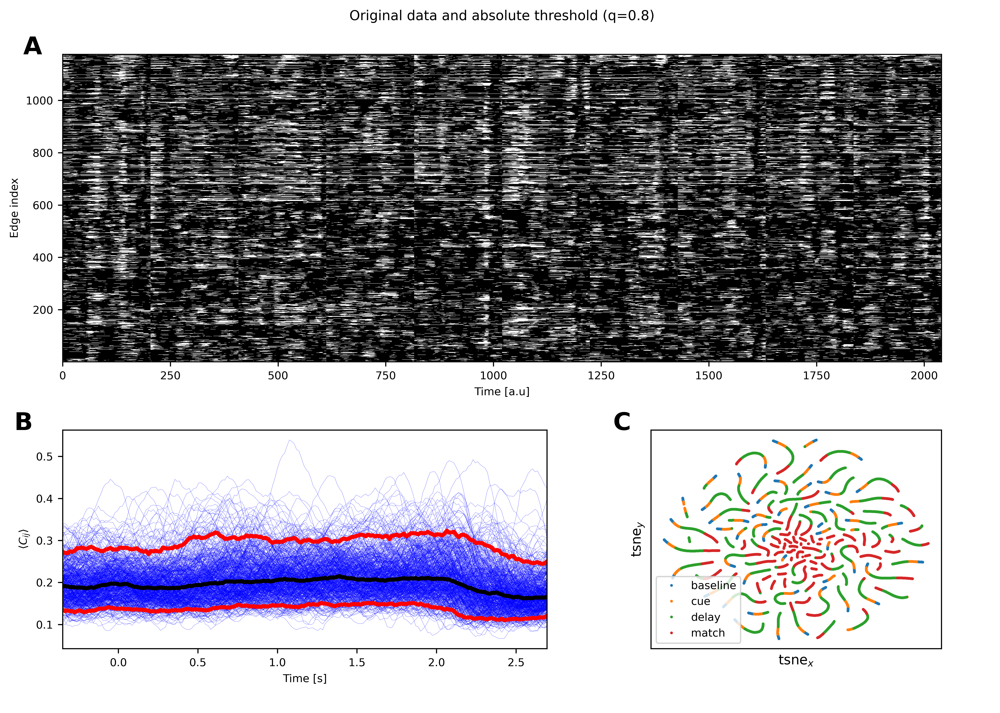

In [11]:
plot_erp_panel(_KS=500, _SURR=False, _REL=False, title=r"Original data and absolute threshold (q=0.8)")

#### Original data and relative threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [00:48<00:00,  9.77s/it]


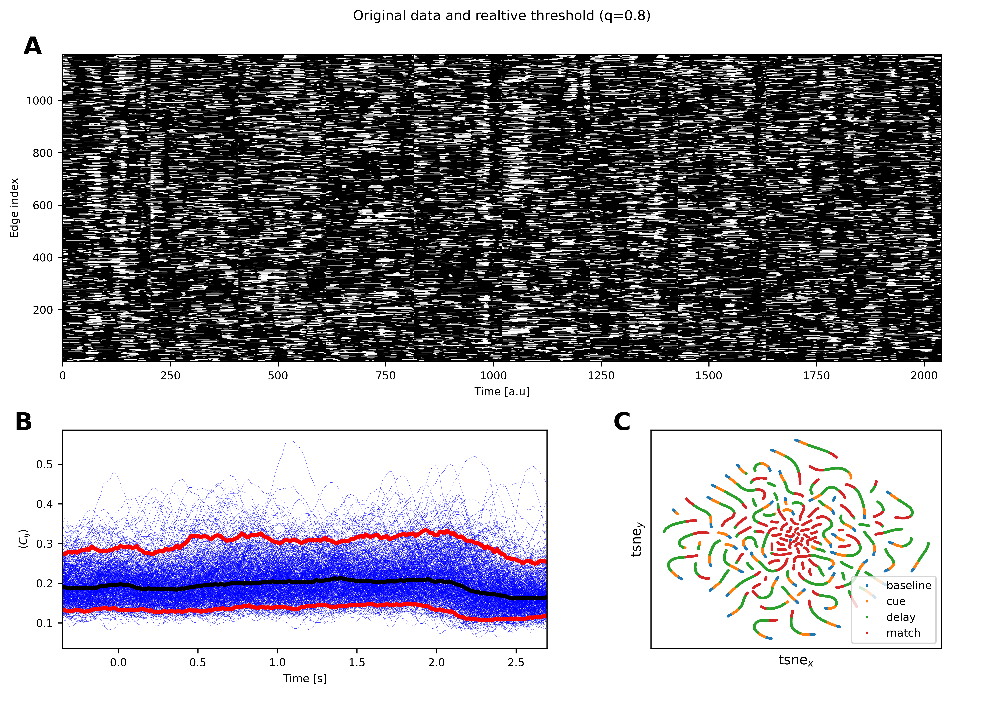

In [12]:
plot_erp_panel(_KS=500, _SURR=False, _REL=True, title=r"Original data and realtive threshold (q=0.8)")

#### Surrogate data and absolute threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [01:18<00:00, 15.75s/it]


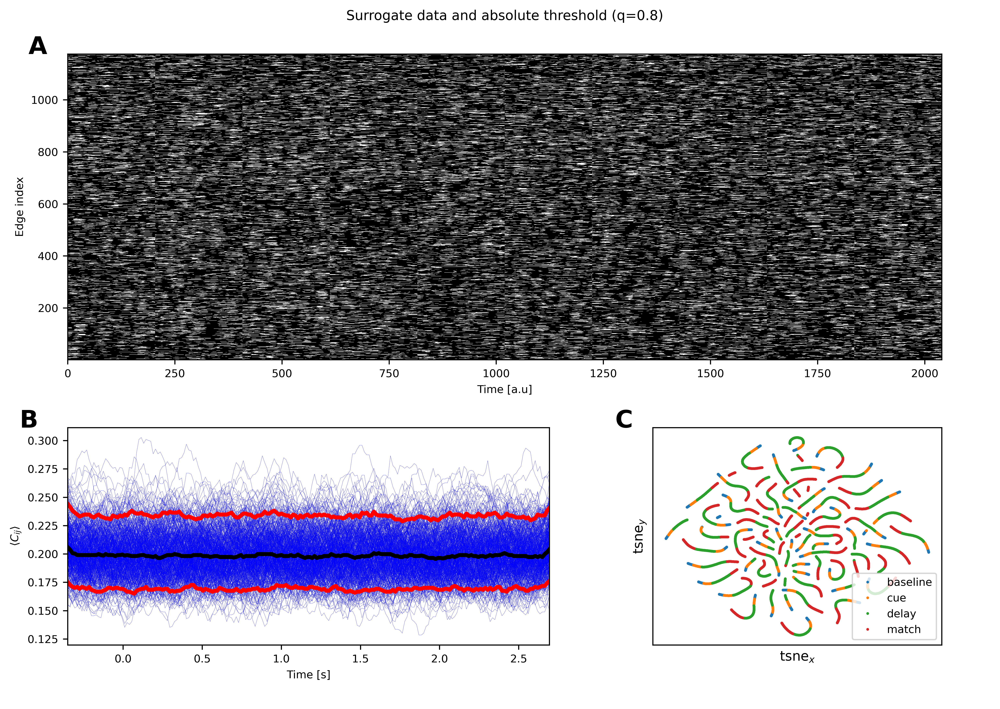

In [13]:
plot_erp_panel(_KS=500, _SURR=True, _REL=False, title=r"Surrogate data and absolute threshold (q=0.8)")

#### Surrogate data and relative threshold (q=0.8)

Computing coherence thresholds


100%|██████████| 5/5 [00:48<00:00,  9.79s/it]


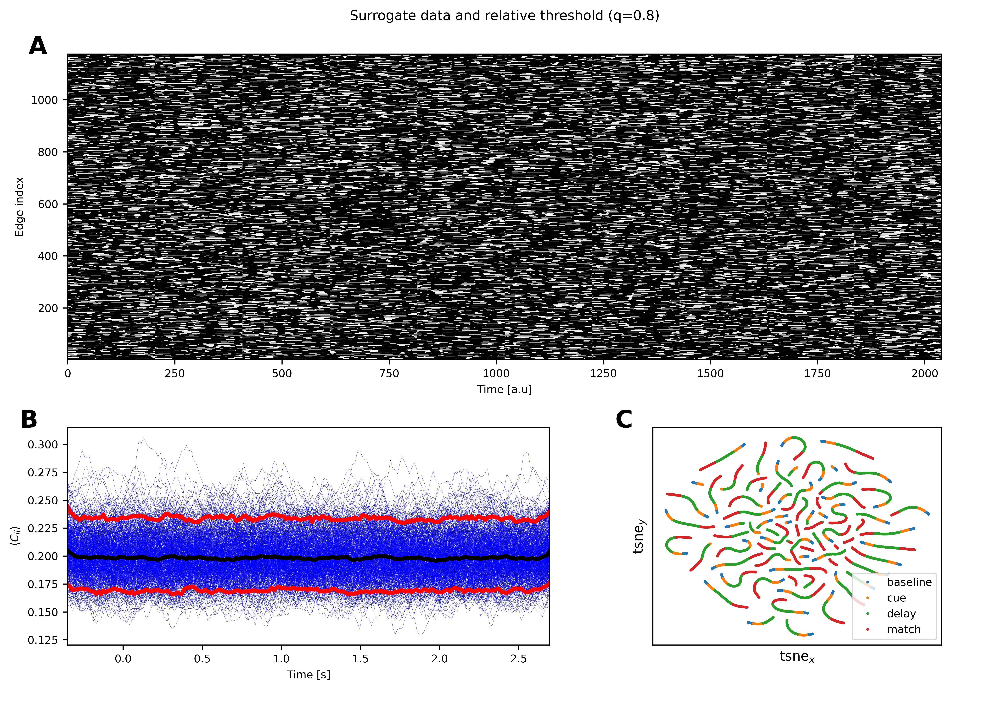

In [14]:
plot_erp_panel(_KS=500, _SURR=True, _REL=True, title=r"Surrogate data and relative threshold (q=0.8)")

### Burstness statistics

In [15]:
def plot_q_dependece(ax, bs_stats,stats,freq,ylabel=None):
    plt.sca(ax)
    # Axis limits
    _xlim0, _xlim1 = bs_stats.thr[0],bs_stats.thr[-1]
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    # Number of edges
    n_edges = bs_stats.sizes["roi"]
    # Compute the median over edges
    _median = bs_stats.isel(stats=stats,freqs=freq).median(dim="roi")
    # Compute the 5% quantile over edges
    _q005   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.05, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    # Compute the 95% quantile over edges
    _q095   = bs_stats.isel(stats=stats,freqs=freq).quantile(0.95, dim="roi", keep_attrs=True) #/ np.sqrt(n_edges)
    for s in range(_median.sizes["stages"]):
        plt.plot(bs_stats.thr, _median.isel(stages=s))
        plt.fill_between(bs_stats.thr, 
                         _q005.isel(stages=s),
                         _q095.isel(stages=s), alpha=0.2)
    plt.vlines(bs_stats.thr.values[1], _ylim0, _ylim1, color="gray")
    plt.vlines(bs_stats.thr.values[6], _ylim0, _ylim1, ls='--', color="gray")
    plt.xlim(_xlim0, _xlim1)
    plt.ylim(_ylim0, _ylim1)
    plt.ylabel(ylabel, fontsize=MEDIUM_SIZE)

def plot_stats_dist(ax, bs_stats, stats, freq, thr, nbins, xlabel=None, legend=None):
    plt.sca(ax)
    _ylim0, _ylim1 = bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").min()-0.05, bs_stats.isel(stats=stats, freqs=freq).median(dim="roi").max()+0.05
    bins=np.linspace(_ylim0, _ylim1,50)
    for i in range(bs_stats.sizes["stages"]):
        plt.hist(bs_stats.isel(stats=stats,stages=i,thr=thr, freqs=freq), bins=bins, density=True, lw=1, histtype='step', fill=False, label=stages[i], orientation='horizontal')
    if isinstance(legend, list):
        plt.legend( prop={'size': 5})
    plt.ylabel(xlabel, fontsize=MEDIUM_SIZE)

In [16]:
def plot_panel_bst(_KS=None, _SURR=False, _REL=False, title=None):
    
    bs_stats = xr.load_dataarray( get_bst_file(ks=_KS, surr=_SURR, rel=_REL) )
    
    
    # For the histograms of each measurement
    nbins  = 100

    fig = plt.figure(figsize=(7, 8), dpi=150)

    gs1 = fig.add_gridspec(nrows=4, ncols=3, left=0.1, right=0.95, bottom=0.05, top=0.9, wspace=0.3, hspace=.3)

    # Panel A
    ax1 = plt.subplot(gs1[0])
    ax2 = plt.subplot(gs1[3])
    ax3 = plt.subplot(gs1[6])
    ax4 = plt.subplot(gs1[9])

    #### Plotting dependence on threshold of the metrics #####
    plot_q_dependece(ax1, bs_stats, 0, 1, ylabel=_stats[0]+" [s]")
    plt.legend(stages, prop={'size': 5})
    plot_q_dependece(ax2, bs_stats, 1, 1, ylabel=_stats[1]+" [s]")
    plot_q_dependece(ax3, bs_stats, 2, 1, ylabel=_stats[2])
    plot_q_dependece(ax4, bs_stats, 3, 1, ylabel=_stats[3])
    plt.xlabel("q", fontsize=MEDIUM_SIZE)

    # Panel B
    ax5 = plt.subplot(gs1[1])
    ax6 = plt.subplot(gs1[4])
    ax7 = plt.subplot(gs1[7])
    ax8 = plt.subplot(gs1[10])

    ##### Histograms for low threshold ####
    # Mean active time
    plot_stats_dist(ax5, bs_stats, 0, 1, 1, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax6, bs_stats, 1, 1, 1, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax7, bs_stats, 2, 1, 1, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax8, bs_stats, 3, 1, 1, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)

    # Panel C
    ax9  = plt.subplot(gs1[2])
    ax10 = plt.subplot(gs1[5])
    ax11 = plt.subplot(gs1[8])
    ax12 = plt.subplot(gs1[11])

    ##### Histograms for high threshold ####
    # Mean active time
    plot_stats_dist(ax9,  bs_stats, 0, 1, 6, nbins, xlabel=None, legend=stages)
    # STD of mean active time
    plot_stats_dist(ax10, bs_stats, 1, 1, 6, nbins, xlabel=None, legend=None)
    # Total active time
    plot_stats_dist(ax11, bs_stats, 2, 1, 6, nbins, xlabel=None, legend=None)
    # CV
    plot_stats_dist(ax12, bs_stats, 3, 1, 6, nbins, xlabel=None, legend=None)
    plt.xlabel("#count", fontsize=MEDIUM_SIZE)
    
    for index in range(12):
        fig.get_axes()[index].spines['right'].set_visible(False)
        fig.get_axes()[index].spines['top'].set_visible(False)

    bg = plot.Background(visible=False)
    #bg.box((0.32, 0.65, 0.01, 0.95), lw=2)
    #bg.box((0.66, 0.99, 0.01, 0.95), lw=2, ls='--')
    bg.axes.text(0.50, 0.96, title, ha='center', fontsize=MEDIUM_SIZE);
    plot.add_panel_letters(fig, axes=[ax1, ax5, ax9], fontsize=18,
                               xpos=[-0.15,-0.15,-0.15], ypos=[1.1, 1.1, 1.1]);
    bg.hline(0.92, x0=0.407, x1=0.637, lw=2)
    bg.hline(0.92, x0=0.71, x1=0.952, lw=2, ls="--")
    plt.savefig(f"img/n5.0.0/qdependence_surr_{_SURR}_ks_{_KS}_rel_{_REL}.png")

#### Original data and absolute threshold

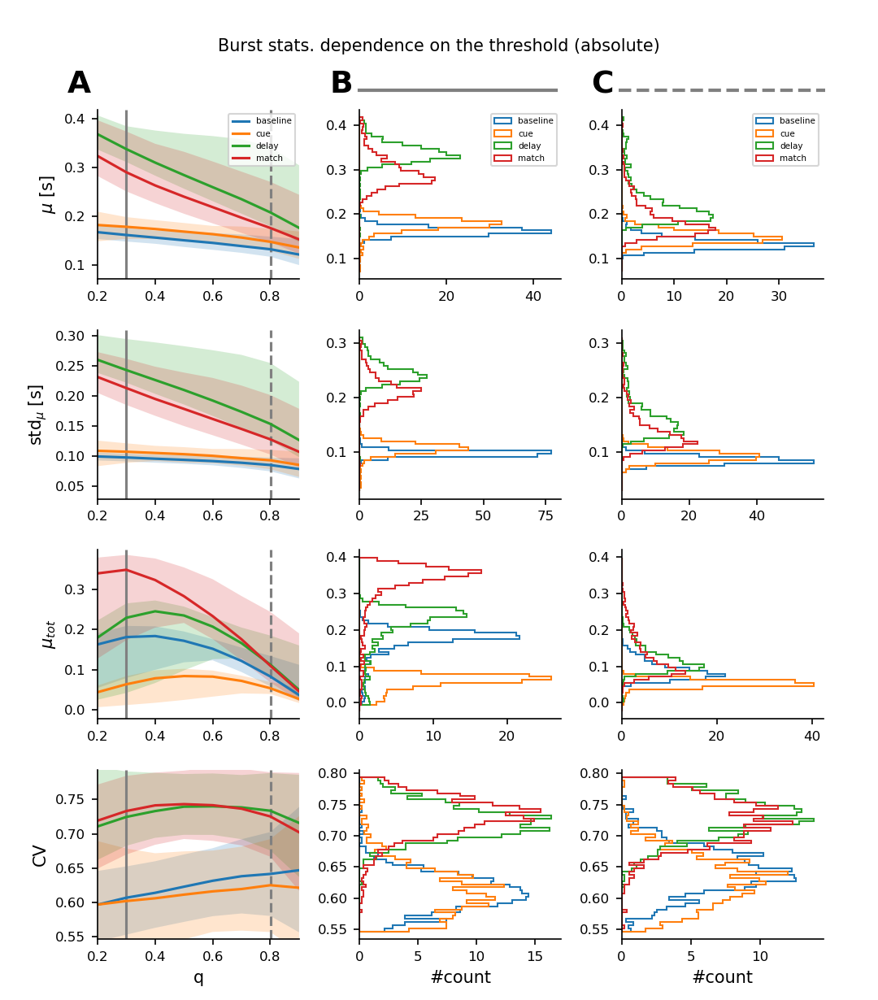

In [17]:
plot_panel_bst(_KS=500, _SURR=False, _REL=False, title="Burst stats. dependence on the threshold (absolute)")

#### Original data and relative threshold

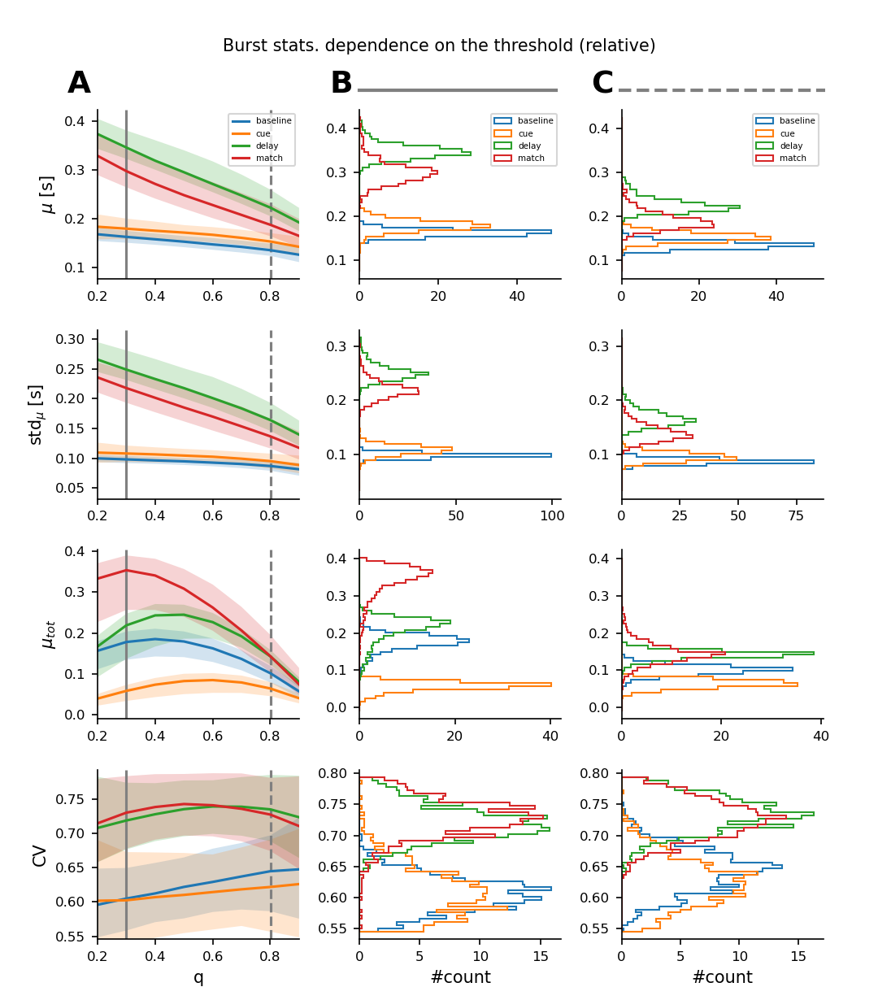

In [18]:
plot_panel_bst(_KS=500, _SURR=False, _REL=True, title="Burst stats. dependence on the threshold (relative)")

#### Surrogate data and absolute threshold

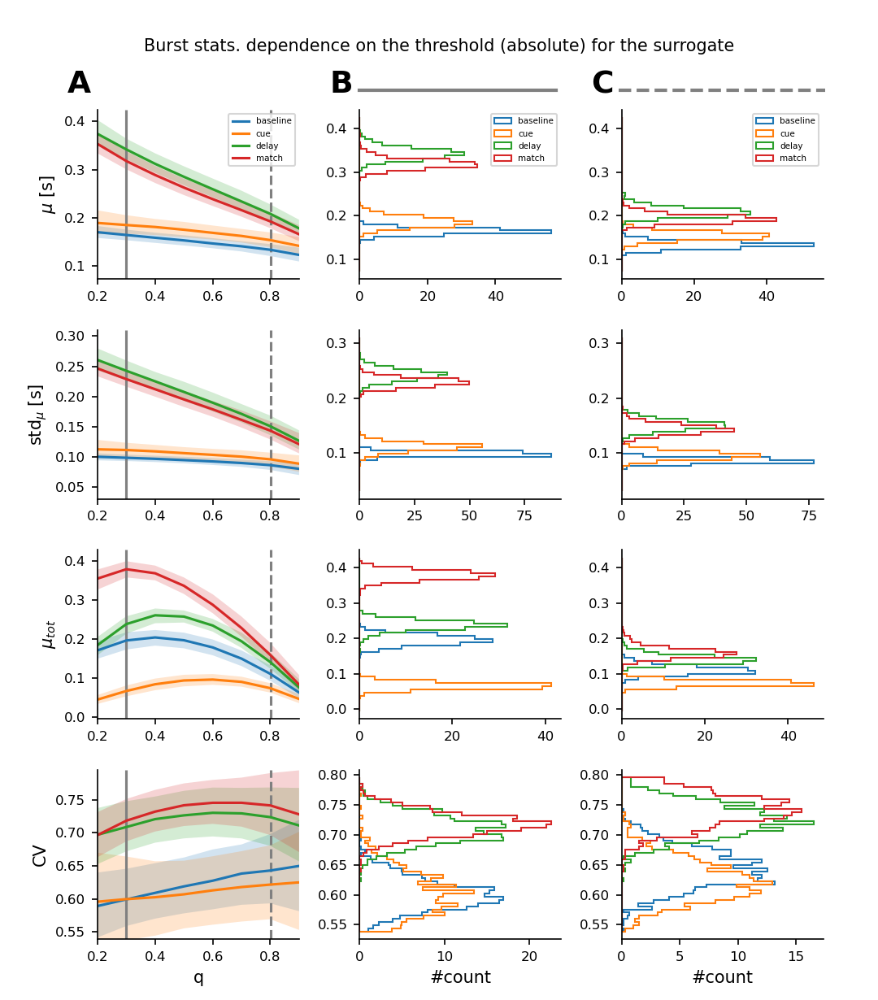

In [19]:
plot_panel_bst(_KS=500, _SURR=True, _REL=False, title="Burst stats. dependence on the threshold (absolute) for the surrogate")

#### Surrogate data and relative threshold

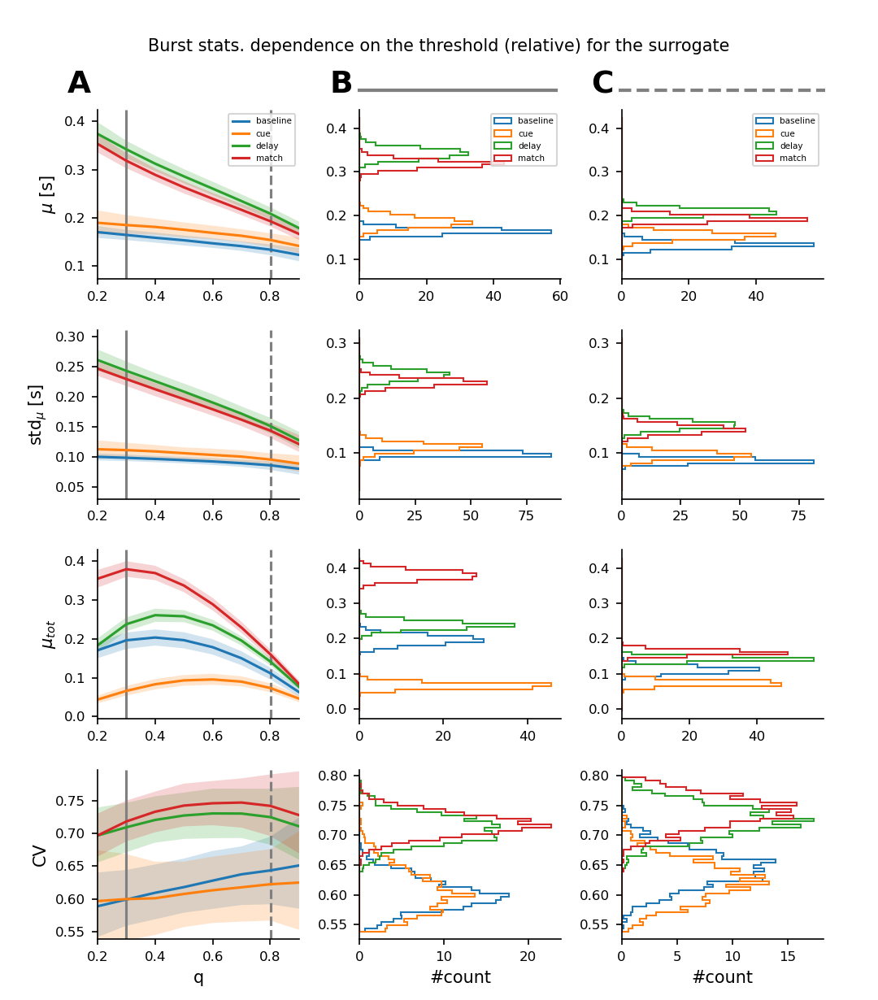

In [20]:
plot_panel_bst(_KS=500, _SURR=True, _REL=True, title="Burst stats. dependence on the threshold (relative) for the surrogate")

### Burstiness statistics - comparison with surrogates

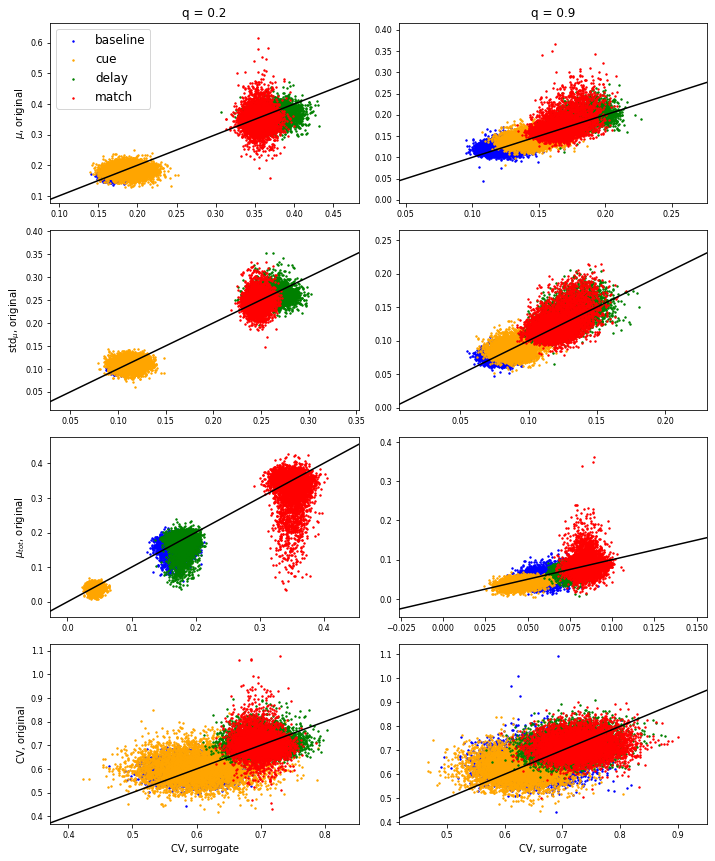

In [97]:
# Original 
bs_o = xr.load_dataarray( get_bst_file(ks=500, surr=False, rel=True) )
# Surrogate
bs_s = xr.load_dataarray( get_bst_file(ks=500, surr=True, rel=True) )

x = np.linspace(-20,20,100)
y = x

plt.figure(figsize=(10,12))
c     = ['blue', 'orange', 'green', 'red']
count = 1
for i in range(bs_o.sizes["stats"]):
    for q in [0,7]:
        plt.subplot(4,2,count)
        for s in range(4):
            plt.scatter(bs_s.isel(thr=q,stages=s,stats=i), bs_o.isel(thr=q,stages=s,stats=i), c=c[s], s=2, label=f"{stages[s]}")
        plt.xlim(bs_s.isel(stats=i, thr=q).min()-0.05, bs_s.isel(stats=i, thr=q).max()+0.05)
        plt.ylim(bs_o.isel(stats=i, thr=q).min()-0.05, bs_o.isel(stats=i, thr=q).max()+0.05)
        if i==0 and q==0: plt.legend(fontsize=BIGGER_SIZE)
        if i==0 and q==0: plt.title(f"q = {bs_o.thr.values[q]}", fontsize=BIGGER_SIZE)
        if i==0 and q==7: plt.title(f"q = {bs_o.thr.values[q].round(2)}", fontsize=BIGGER_SIZE)
        if q==0: plt.ylabel(f"{_stats[i]}" + ", original", fontsize=MEDIUM_SIZE)
        if i==3: plt.xlabel(f"{_stats[i]}" + ", surrogate", fontsize=MEDIUM_SIZE)
        plt.plot(x,y, "k")
        count+=1
plt.tight_layout()

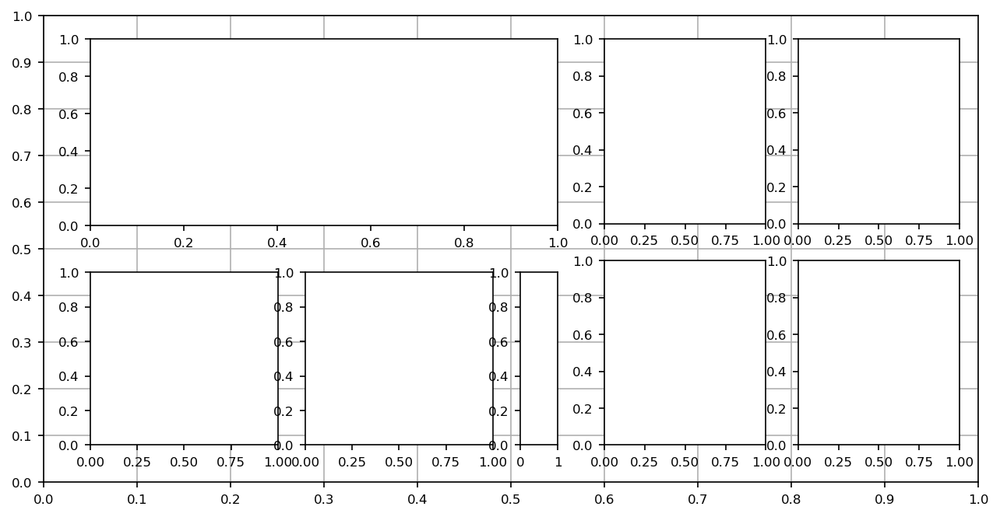

In [21]:
fig = plt.figure(figsize=(8., 4), dpi=150)

gs1 = fig.add_gridspec(nrows=1, ncols=1, left=0.05, right=0.55, bottom=0.55, top=0.95)
gs2 = fig.add_gridspec(nrows=1, ncols=3, width_ratios=(1,1,0.2), left=0.05, right=0.55, bottom=0.08, top=0.45)
gs3 = fig.add_gridspec(nrows=2, ncols=2, left=0.6, right=0.98, bottom=0.08, top=0.95)

ax  = []

# Panel A
ax1 = plt.subplot(gs1[0])

# Panel B
ax2 = plt.subplot(gs2[0])
ax3 = plt.subplot(gs2[1])
ax4 = plt.subplot(gs2[2])

# Panels C-E
ax5 = plt.subplot(gs3[0])
ax6 = plt.subplot(gs3[1])
ax7 = plt.subplot(gs3[2])
ax8 = plt.subplot(gs3[3])

bg = plot.Background(visible=True)

#### Burstness vs active time (default threshold)

In [ ]:
plt.figure(figsize=(15,20))
count = 1
x_min, x_max = bs_stats[...,0].min(), bs_stats[...,0].max()
y_min, y_max = bs_stats[...,3].min(), bs_stats[...,3].max()
bins         = [np.linspace(x_min,x_max,20),np.linspace(y_min, y_max,20)]
for j in tqdm( range(len(net.freqs)) ):
    Hb, xb, yb = np.histogram2d(bs_stats[:,j,0,0], bs_stats[:,j,0,3], 
                                bins=bins, density = True  )
    for i in range(1,len(stages)):     
        # Plotting top links
        plt.subplot(len(net.freqs), len(stages)-1, count)
        H, xb, yb = np.histogram2d(bs_stats[:,j,i,0], bs_stats[:,j,i,3], 
                               bins=bins, density = True )
        plt.imshow(H-Hb, aspect='auto', cmap='RdBu_r', origin='lower', 
                   extent=[1000*xb[0],1000*xb[-1],yb[0],yb[-1]], 
                   interpolation='gaussian', vmin=-1000, vmax=1000)
        plt.colorbar(extend='both')
        if j < 4 : plt.xticks([])
        if i > 1 : plt.yticks([])
        if j == 4: plt.xlabel('Mean burst dur. [ms]', fontsize=15)
        if j == 0: plt.title(f'{stages[i]}-baseline', fontsize=15)
        if i == 1: plt.ylabel('CV', fontsize=15)
        count += 1
plt.tight_layout()

#### Burstiness vs electrode distance (default threshold)

In [ ]:
plt.figure(figsize=(15,20))
count = 1
x_min, x_max = d_eu.min(), d_eu.max()
y_min, y_max = bs_stats[...,3].min(), bs_stats[...,3].max()
bins         = [np.linspace(x_min,x_max,20),np.linspace(y_min, y_max,20)]
for j in tqdm( range(len(net.freqs)) ):
    Hb, xb, yb = np.histogram2d(d_eu, bs_stats[:,j,0,3], 
                                bins=bins, density = True  )
    for i in range(1,len(stages)):     
        # Plotting top links
        plt.subplot(len(net.freqs), len(stages)-1, count)
        H, xb, yb = np.histogram2d(d_eu, bs_stats[:,j,i,3], 
                               bins=bins, density = True )
        plt.imshow(H-Hb, aspect='auto', cmap='RdBu_r', origin='lower', 
                   extent=[xb[0],xb[-1],yb[0],yb[-1]], 
                   interpolation='gaussian', vmin=-0.02, vmax=0.02)
        plt.colorbar()
        if j < 4 : plt.xticks([])
        if i > 1 : plt.yticks([])
        if j == 4: plt.xlabel('Euclidian distance', fontsize=15)
        if j == 0: plt.title(f'{stages[i]}-baseline', fontsize=15)
        if i == 1: plt.ylabel('CV', fontsize=15)
        count += 1
plt.tight_layout()

#### Dependence on threshold (gif)

##### CV vs. Mean burst duration

In [ ]:
x_min, x_max = cv[...,0,:].min(), cv[...,0,:].max()
y_min, y_max = cv[...,3,:].min(), cv[...,3,:].max()
bins         = [np.linspace(x_min,x_max,20),np.linspace(y_min, y_max,20)]
for iq in tqdm(  range(cv.shape[-1]) ):
    plt.figure(figsize=(15,20))
    count = 1
    for j in range(len(net.freqs)):
        for i in range(0,len(stages)):     
            # Plotting top links
            plt.subplot(len(net.freqs), len(stages), count)
            H, xb, yb = np.histogram2d(cv[:,j,i,0,iq], cv[:,j,i,3,iq], 
                                   bins=bins, density = True )
            plt.imshow(H, aspect='auto', cmap='viridis', origin='lower', 
                       extent=[1000*xb[0],1000*xb[-1],yb[0],yb[-1]], 
                       interpolation='gaussian', vmin=0, vmax=300)
            plt.colorbar(extend='max')
            if j < 4 : plt.xticks([])
            if i > 1 : plt.yticks([])
            if j == 4: plt.xlabel('Mean burst dur. [ms]', fontsize=15)
            if j == 0: plt.title(f'{stages[i]}', fontsize=15)
            if i == 0: plt.ylabel('CV', fontsize=15)
            count += 1
    plt.suptitle(f'q = {q_list[iq]:.2f}', fontsize=20) 
    plt.tight_layout()
    plt.savefig(f'img/cv_mut_{iq}.png')
    plt.close()

##### CV vs. Fraction of active time

In [ ]:
x_min, x_max = cv[...,2,:].min(), cv[...,2,:].max()
y_min, y_max = cv[...,3,:].min(), cv[...,3,:].max()
bins         = [np.linspace(x_min,x_max,20),np.linspace(y_min, y_max,20)]
for iq in tqdm(  range(cv.shape[-1]) ):
    plt.figure(figsize=(15,20))
    count = 1
    for j in range(len(net.bands)):
        for i in range(0,len(stages)):     
            # Plotting top links
            plt.subplot(len(net.bands), len(stages), count)
            H, xb, yb = np.histogram2d(cv[:,j,i,2,iq], cv[:,j,i,3,iq], 
                                   bins=bins, density = True )
            plt.imshow(H, aspect='auto', cmap='viridis', origin='lower', 
                       extent=[xb[0],xb[-1],yb[0],yb[-1]], 
                       interpolation='gaussian', vmin=0, vmax=300)
            plt.colorbar(extend='max')
            if j < 4 : plt.xticks([])
            if i > 1 : plt.yticks([])
            if j == 4: plt.xlabel('Fraction of active time', fontsize=15)
            if j == 0: plt.title(f'{stages[i]}', fontsize=15)
            if i == 0: plt.ylabel('CV', fontsize=15)
            count += 1
    plt.suptitle(f'q = {q_list[iq]:.2f}', fontsize=20)  
    plt.tight_layout()
    plt.savefig(f'img/cv_mutot_{iq}.png')
    plt.close()

##### CV vs. channel euclidean distance

In [ ]:
x_min, x_max = d_eu.min(), d_eu.max()
y_min, y_max = cv[...,3,:].min(), cv[...,3,:].max()
bins         = [np.linspace(x_min,x_max,20),np.linspace(y_min, y_max,20)]
for iq in tqdm(  range(cv.shape[-1]) ):
    plt.figure(figsize=(15,20))
    count = 1
    for j in range(len(net.bands)):
        for i in range(0,len(stages)):     
            # Plotting top links
            plt.subplot(len(net.bands), len(stages), count)
            H, xb, yb = np.histogram2d(d_eu, cv[:,j,i,3,iq], 
                                   bins=bins, density = True )
            plt.imshow(H, aspect='auto', cmap='viridis', origin='lower', 
                       extent=[xb[0],xb[-1],yb[0],yb[-1]], 
                        vmin=0, vmax=0.02)
            plt.colorbar(extend='max')
            if j < 4 : plt.xticks([])
            if i > 1 : plt.yticks([])
            if j == 4: plt.xlabel(r'd_{\rm eu}', fontsize=15)
            if j == 0: plt.title(f'{stages[i]}', fontsize=15)
            if i == 0: plt.ylabel('CV', fontsize=15)
            count += 1
    plt.suptitle(f'q = {q_list[iq]:.2f}', fontsize=20) 
    plt.tight_layout()
    plt.savefig(f'img/cv_deu_{iq}.png')
    plt.close()

### Meta-connectivity analysis

In [ ]:
from GDa.net.layerwise import *

In [ ]:
# Default threshold
kw = dict(q=None, keep_weights=False)

# Instantiating a temporal network object without thresholding the data
net =  temporal_network(coh_file='super_tensor.nc', monkey=dirs['monkey'][nmonkey], 
                        session=1, date='150128', trial_type=[1],
                        behavioral_response=[1], wt=(20,20), drop_trials_after=True,
                        relative=True, verbose=True, **kw)

In [ ]:
CCij = np.zeros([len(net.freqs), net.super_tensor.sizes['roi'],net.super_tensor.sizes['roi'],len(stages)])

for s in tqdm( range(len(stages)) ):
    aux = net.get_data_from(stage=stages[s],pad=False)
    for b in range(len(net.freqs)):
        CCij[b,:,:,s] = np.corrcoef(aux[:,b,:].values, rowvar=True) 
CCij[:,range(1176),range(1176),:] = 0

In [ ]:
plt.figure(figsize=(20,20))
count = 1
for b in range(len(net.freqs)):
    for i in range(len(stages)):
        plt.subplot(len(net.freqs),len(stages),count)
        plt.imshow(CCij[b,...,i], aspect='auto', cmap='RdBu_r', origin='lower', 
                   vmin=-CCij[b,...].mean()*3, vmax=CCij[b,...].mean()*3)
        if b == 0: plt.title(stages[i], fontsize=15)
        if i == 0: plt.ylabel(band_names[b], fontsize=15)
        plt.colorbar(extend='both')
        count+=1
plt.tight_layout()

In [ ]:
print(f'{CCij.shape=}')

In [ ]:
p_mc, m_mc = [], []
for band in tqdm( range(len(net.freqs)) ):
    p, m  = compute_network_partition(CCij[band,:,:,None,:], kw_louvain=dict(qtype='sta'), backend='brainconn',verbose=True)
    p_mc += [p]
    m_mc += [m]
p_mc = xr.concat(p_mc, dim='freqs')
m_mc = xr.concat(m_mc, dim='freqs')

In [ ]:
idx   = np.argsort( p_mc.isel(trials=0,times=0,freqs=0) )

#### Plotting on clustering order

In [ ]:
plt.figure(figsize=(20,20))
count = 1
for b in range(len(net.freqs)):
    for i in range(len(stages)):
        plt.subplot(len(net.freqs),len(stages),count)
        # Sorting by module label
        idx   = np.argsort( p_mc.isel(trials=0,times=i,freqs=b) )
        A     = CCij[b,...,i]
        plt.imshow(A[np.ix_(idx,idx)], aspect='auto', cmap='RdBu_r', origin='lower', 
                   vmin=-CCij[b,...].mean()*3, vmax=CCij[b,...].mean()*3)
        if b == 0: plt.title(stages[i], fontsize=15)
        if i == 0: plt.ylabel(band_names[b], fontsize=15)
        plt.colorbar(extend='both')
        count+=1
plt.savefig('img/mc_surr.png', dpi=200)
plt.tight_layout()

#### Trimer Strength

In [ ]:
plt.figure(figsize=(20,20))
count=1
for b in range(len(net.freqs)):
    for i in range(len(stages)):
        TrS     = []
        plt.subplot(len(net.freqs),len(stages),count)
        membership = p_mc.isel(freqs=b,trials=0,times=i).values
        for c in np.unique(membership):
            idx = np.arange(CCij.shape[1],dtype=int)[membership==c]
            #r_i = net.super_tensor.attrs['sources'][idx]
            A   = CCij[b,...,i]
            A   = A[idx,idx[:,None]]
            TrS += [A.sum()]
        plt.plot(range(membership.max()+1), TrS)
        plt.xlim(0, membership.max())
        if b == 0: plt.title(stages[i], fontsize=15)
        if i == 0: plt.ylabel(band_names[b], fontsize=15)
        if b == len(net.freqs)-1: plt.xlabel('Community number', fontsize=15)
        count +=1

### Cross-frequency coupling

In [ ]:
# All possible band pairs
i,j = np.triu_indices(5,k=1)
bp  = np.array([i,j]).T

In [ ]:
CCmulti = np.zeros([len(bp),net.super_tensor.sizes['roi'],net.super_tensor.sizes['roi'],len(stages)])

for s in tqdm( range(len(stages)) ):
    aux = net.get_data_from(stage=stages[s], pad=False)
    for b, band_1, band_2 in zip(range( len(bp) ), i, j):
        CCmulti[b,...,s]=\
        np.corrcoef(aux[:,band_1,:], aux[:,band_2,:], rowvar=True)[net.super_tensor.sizes['roi']:,:net.super_tensor.sizes['roi']]

In [ ]:
plt.figure(figsize=(20,8))
count = 1
for b in range( len(bp) ):
    plt.subplot(2,5,count)
    plt.imshow(CCmulti[b,...,2], aspect='auto', cmap='RdBu_r', origin='lower', vmin=-0.04,vmax=0.04)
    plt.colorbar(extend='both')
    plt.title(f'band {bp[b,0]}-band {bp[b,1]}', fontsize=15)
    count+=1
plt.tight_layout()

### Comparison with fixation

In [ ]:
# Default threshold
kw = dict(q=q_thr, keep_weights=False)

# Instantiating a temporal network object without thresholding the data
net_fix =  temporal_network(coh_file='super_tensor.nc', monkey=dirs['monkey'][nmonkey], 
                        session=1, date='150128', trial_type=[2],
                        behavioral_response=None, wt=(30,30), drop_trials_after=True,
                        relative=True, verbose=True, **kw)

In [ ]:
plt.figure(figsize=(20,30))
for i in range(len(band_names)):
    plt.subplot(len(band_names), 1, i+1)
    plt.imshow(net_fix.super_tensor[:,i,:10,:].stack(observations=('trials','times')), 
               aspect = 'auto', cmap = 'gray', origin = 'lower', 
               extent = [0, 10*len(net.time), 1, net.super_tensor.sizes['roi']], vmin = 0, vmax = 1)
    plt.colorbar()
    plt.ylabel('Pair Number')
    plt.xlabel('Time [a.u.]')
    plt.title(band_names[i])

In [ ]:
plt.figure(figsize=(20,30))
aux = scipy.stats.zscore(net_fix.super_tensor.mean(dim='trials'), axis=-1)
for i in range(len(band_names)):
    plt.subplot(len(band_names), 1, i+1)
    plt.imshow(aux[:,i,:], 
               aspect = 'auto', cmap = 'RdBu_r', origin = 'lower',
               extent = [net.time[0], net.time[-1], 1, net.super_tensor.sizes['roi']], 
               vmin=-4, vmax=4)
    plt.colorbar()
    plt.ylabel('Pair Number')
    plt.xlabel('Time [a.u.]')
    plt.title(band_names[i])

In [ ]:
# Redefining masks
net_fix.create_stage_masks(flatten=False)

bs_stats_fix = np.zeros((net_fix.super_tensor.sizes['roi'],net_fix.super_tensor.sizes['freqs'],len(stages), 4))

n_samp = []
for stage in stages:
    n_samp += [net_fix.get_number_of_samples(stage=stage, total=True)]

net_fix.create_stage_masks(flatten=False)
    
for i in tqdm( range(len(band_names)) ):
    bs_stats_fix[:,i,...] = bst.tensor_burstness_stats(net_fix.super_tensor.isel(freqs=i).values, net_fix.s_mask, 
                                               drop_edges=True, samples=n_samp, 
                                               dt=delta/net_fix.super_tensor.attrs['fsample'], 
                                               n_jobs=-1);

In [ ]:
titles = ['Mean burst duration', 'STD mean burst dur.','Norm. total active time', 'CV']
colors = ['b', 'r', 'g', 'm']
plt.figure(figsize=(20,20))
count = 1
for i in range(len(net_fix.freqs)):
    for k in range(4):
        plt.subplot(5,4,count)
        for j in [2]:
            sns.kdeplot(data=bs_stats_fix[:,i,j,k], shade=False, color=colors[j], label=f'{stages[j]}, FIX')
            sns.kdeplot(data=bs_stats[:,i,j,k], shade=False, ls='--', color=colors[j], label=f'{stages[j]}, ODRT')
            if i==0: plt.title(titles[k], fontsize=15)
            #if i<4: plt.xticks([])
            if count in [1,5,8,11,14]: plt.ylabel(f'Band {i}', fontsize=15)
        plt.legend()
        count+=1
plt.tight_layout()

In [ ]:
net_fix.create_stage_masks(flatten=True)

In [ ]:
plt.figure(figsize=(8,30))
for j in tqdm( range(len(net_fix.freqs)) ):
    aux = net_fix.super_tensor.isel(freqs=j, trials=slice(0,50))
    aux = aux.stack(observations=("trials","times"))
    Y = TSNE(n_components=2, 
             metric='hamming', 
             perplexity=30.0,
             square_distances=True,
             n_jobs=40).fit_transform(aux.T)
    plt.subplot(len(net_fix.freqs), 1, j+1)
    for i in range(len(stages)):
        plt.plot(Y[net_fix.s_mask[stages[i]][:50*len(net_fix.time)],0], 
                 Y[net_fix.s_mask[stages[i]][:50*len(net_fix.time)],1], 
                 '.', ms=2, label = stages[i])
        plt.legend()
    plt.title(f'band {j}',    fontsize=15)
    plt.ylabel(r'tsne$_{y}$', fontsize=15)
    plt.xlabel(r'tsne$_{x}$', fontsize=15)
plt.tight_layout()

### Comparison with failed trials

In [ ]:
# Default threshold
kw = dict(q=q_thr, keep_weights=False)

# Instantiating a temporal network object without thresholding the data
net_0 =  temporal_network(coh_file=_COH_FILE, monkey=dirs['monkey'][nmonkey], 
                        session=1, date='150128', trial_type=[1],
                        behavioral_response=[0], wt=(30,30), drop_trials_after=True,
                        relative=True, verbose=True, **kw)

In [ ]:
plt.figure(figsize=(20,30))
for i in range(len(band_names)):
    plt.subplot(len(band_names), 1, i+1)
    plt.imshow(net_0.super_tensor[:,i,:,:].stack(observations=('trials','times')), 
               aspect = 'auto', cmap = 'gray', origin = 'lower', 
               extent = [0, 16*len(net_0.time), 1, net_0.super_tensor.sizes['roi']], vmin = 0, vmax = 1)
    plt.colorbar()
    plt.ylabel('Pair Number')
    plt.xlabel('Time [a.u.]')
    plt.title(band_names[i])

In [ ]:
plt.figure(figsize=(20,30))
aux = scipy.stats.zscore(net_0.super_tensor.mean(dim='trials'), axis=-1)
for i in range(len(band_names)):
    plt.subplot(len(band_names), 1, i+1)
    plt.imshow(aux[:,i,:], 
               aspect = 'auto', cmap = 'RdBu_r', origin = 'lower',
               extent = [net.time[0], net.time[-1], 1, net.super_tensor.sizes['roi']], 
               vmin=-4, vmax=4)
    plt.colorbar()
    plt.ylabel('Pair Number')
    plt.xlabel('Time [a.u.]')
    plt.title(band_names[i])

In [ ]:
# Redefining masks
net_0.create_stage_masks(flatten=False)

bs_stats_0 = np.zeros((net_0.super_tensor.sizes['roi'],net_0.super_tensor.sizes['freqs'],len(stages), 4))

n_samp = []
for stage in stages:
    n_samp += [net_0.get_number_of_samples(stage=stage, total=True)]

net_0.create_stage_masks(flatten=False)
    
for i in tqdm( range(len(band_names)) ):
    bs_stats_0[:,i,...] = bst.tensor_burstness_stats(net_0.super_tensor.isel(freqs=i).values, net_0.s_mask, 
                                               drop_edges=True, samples=n_samp, 
                                               dt=delta/net_fix.super_tensor.attrs['fsample'], 
                                               n_jobs=-1);

In [ ]:
titles = ['Mean burst duration', 'STD mean burst dur.','Norm. total active time', 'CV']
colors = ['b', 'r', 'g', 'm']
plt.figure(figsize=(20,20))
count = 1
for i in range(len(net_0.freqs)):
    for k in range(4):
        plt.subplot(5,4,count)
        for j in [2]:
            sns.kdeplot(data=bs_stats_0[:,i,j,k], shade=False, color=colors[j], label=f'{stages[j]}, Failed')
            sns.kdeplot(data=bs_stats[:,i,j,k], shade=False, ls='--', color=colors[j], label=f'{stages[j]}, ODRT')
            #sns.histplot(data=bs_stats_0[:,i,j,k], stat='density', color=colors[j], label=f'{stages[j]}, FIX')
            #sns.histplot(data=bs_stats[:,i,j,k],   stat='density', color=colors[j], label=f'{stages[j]}, ODRT')
            if i==0: plt.title(titles[k], fontsize=15)
            #if i<4: plt.xticks([])
            if count in [1,5,8,11,14]: plt.ylabel(f'Band {i}', fontsize=15)
        plt.legend()
        count+=1
plt.tight_layout()